# Explore LPJ-GUESS data

This notebook explores the data from the paper [doi:10.21203/rs.3.rs-1143422/v1](https://doi.org/10.21203/rs.3.rs-1143422/v1) as input for the SEMI-REALISTIC simulation (check Simulation_plan)

In [1]:
# why total is not 1?
# attrs are not right in the comparison
# plot difference between GCM and modified idealized
# and others GCM
# definition of peatland
# single plot: optional the background and max is the max of the da not 100

In [2]:
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib as mpl
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from dataset_manipulation import *
from surfdatamaplib import *
from lpjguess import *

# <div class="alert alert-success">Import and explore the data</div>

In [3]:
# Paths to the data:
foldername = "../data/LPJ-GUESS/"
folder_out='/Users/adelezaini/Desktop/master-thesis/processed-data/'

### Land fraction of NAT PFT vs PEATLAND
LPJ-GUESS Dynamic Vegetation model consider natural PFT and PEATLAND, which is considered as C3 and C4 grass in other models (source?). $\rightarrow$ checking NorESM data it makes sense (artic C3 grass and C3 grass)

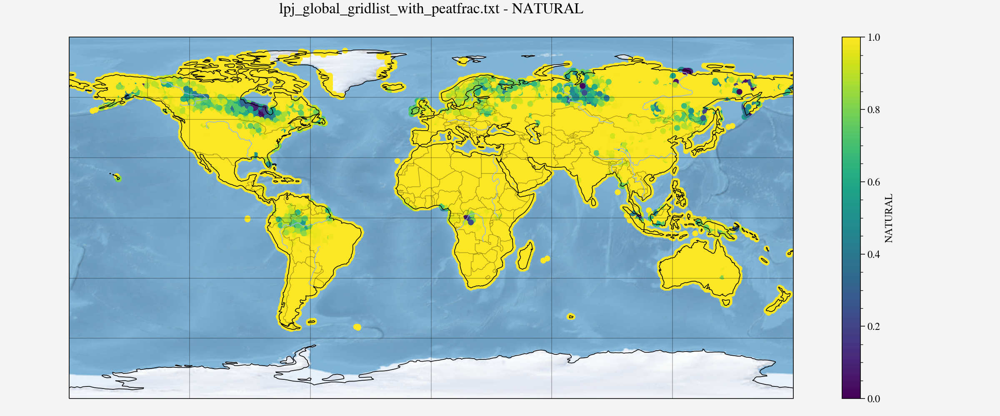

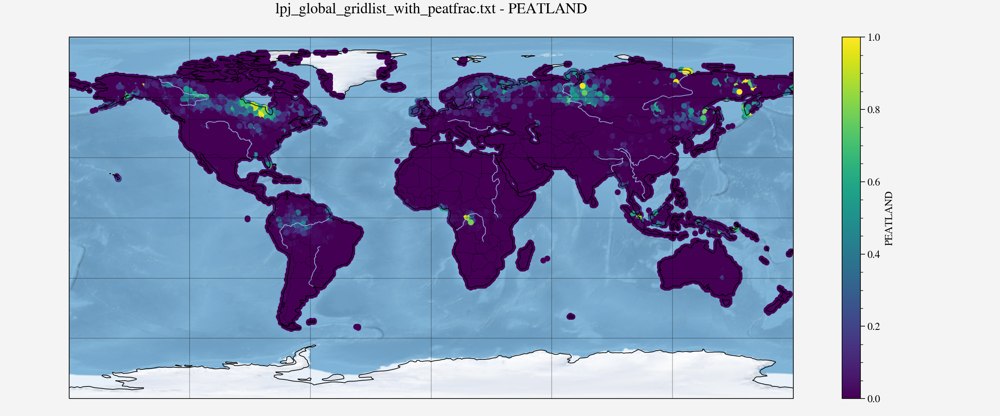

In [4]:
fn = 'lpj_global_gridlist_with_peatfrac.txt'
lndcover = pd.read_csv(foldername+fn, sep="\t")

fig = plt.figure(1, figsize=[12,5])
ax = plt.axes(projection=ccrs.PlateCarree())
#cut_extent_Orthographic(ax, lat=20)
lndcover.plot.scatter(ax=ax, x='Lon', y='Lat', c='NATURAL', cmap='viridis')
ax_map_properties(ax, earth=True)
ax.set_title(fn+' - NATURAL',y=1.05,size='x-large') #, y=1.15, 
plt.tight_layout()
plt.show()

fig = plt.figure(1, figsize=[12,5])
ax = plt.axes(projection=ccrs.PlateCarree())
#cut_extent_Orthographic(ax, lat=20)
lndcover.plot.scatter(ax=ax, x='Lon', y='Lat', c=lndcover.columns[3], vmin=0, vmax=1,cmap='viridis')
ax_map_properties(ax, earth=True)
ax.set_title(fn+' - PEATLAND',y=1.05,size='x-large') #, y=1.15, 
plt.tight_layout()
plt.show()

### Gridlist: gridcells considered in the LPJ-GUESS study

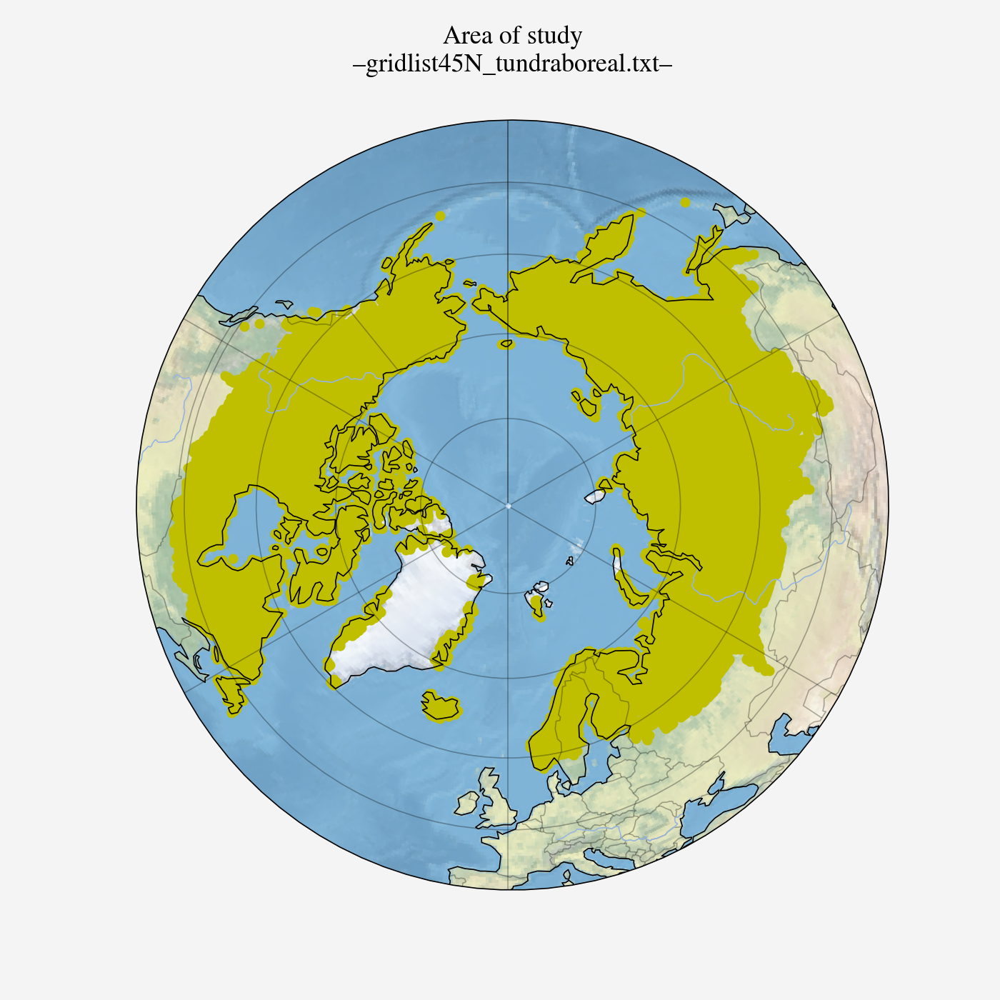

In [5]:
# Import the gridlist (lon-lat lists)
fn = 'gridlist45N_tundraboreal.txt'
lonlat = pd.read_csv(foldername+fn, sep="\t", header=None)
# Name the un-named columns
lonlat.columns = ['Lon', 'Lat']
#data.columns = ['LONGXY', 'LATIXY'] #data = data.to_xarray()

# Plot the study area
fig = plt.figure(1, figsize=[7,7])
ax = plt.axes(projection=ccrs.Orthographic(0, 90))
cut_extent_Orthographic(ax, lat=40)

lonlat.plot.scatter(ax=ax, x='Lon', y='Lat', transform = ccrs.PlateCarree(), color='y')
ax_map_properties(ax, earth=True, gridlines=True)
ax.set_title("Area of study\n–"+fn+"–",y=1.05,size='x-large') #, y=1.15, #plt.tight_layout()
plt.show()

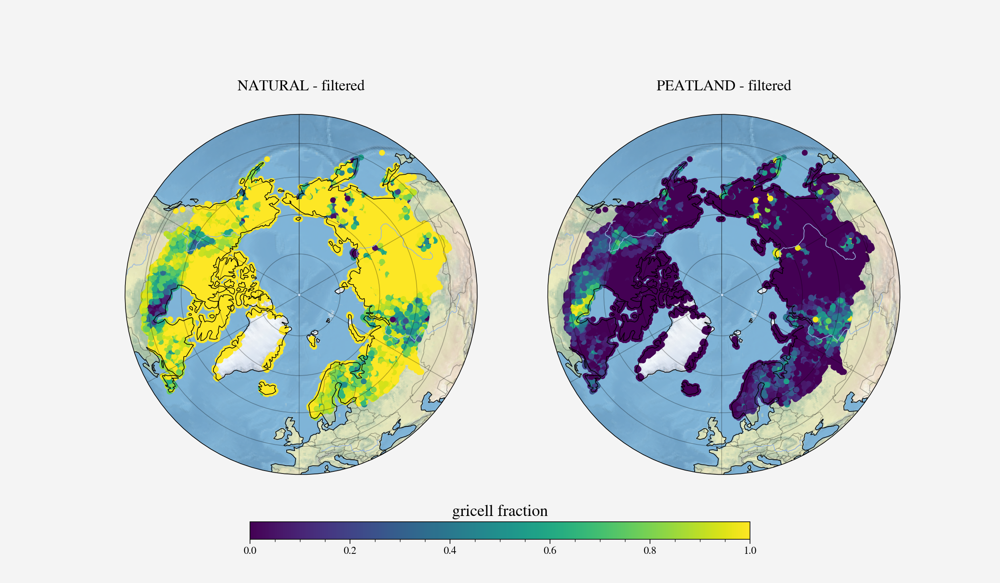

In [6]:
df_tot = filter_lonlat(lndcover, lonlat)


fig, (ax1, ax2) = plt.subplots(1, 2, subplot_kw={'projection': ccrs.Orthographic(0, 90)}, figsize = [12,7])
cut_extent_Orthographic(ax1, lat=40)
df_tot.plot.scatter(ax=ax1, x='Lon', y='Lat', c='NATURAL', cmap='viridis', transform = ccrs.PlateCarree(),colorbar=False)
ax_map_properties(ax1, earth=True)
ax1.set_title('NATURAL - filtered',y=1.05,size='x-large') #, y=1.15, 

cut_extent_Orthographic(ax2, lat=40)
cs=df_tot.plot.scatter(ax=ax2, x='Lon', y='Lat', c=lndcover.columns[3], cmap='viridis', transform = ccrs.PlateCarree(),colorbar=False)
ax_map_properties(ax2, earth=True)
ax2.set_title('PEATLAND - filtered',y=1.05,size='x-large') #, y=1.15, 

# Add colorbar in the remaining axis
#plt.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.9, wspace=0.1, hspace=0.1)
cbar_ax = fig.add_axes([0.25, 0.075, 0.5, 0.03]) #[left, bottom, width, height]
cbar=fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=1), cmap=mpl.cm.viridis), cax=cbar_ax ,orientation='horizontal')
cbar.ax.set_title('gricell fraction', size = 14 )

plt.show()

## PFTs in this study

In [7]:
pftnames = pftnames_LPJGUESS(foldername+'FPC/'+'fpc1971to2000.txt')

pftnames_da = xr.DataArray(pftnames, coords={'natpft':range(23)})
display(pftnames_da.rename('LPJGUESS study').to_dataframe())

,LPJGUESS study
natpft,
0,BNE
1,BINE
2,BNS
3,TeNE
4,TeBE
5,IBS
6,TeBS
7,C3G
8,HSE


# <div class="alert alert-success">FPC (foliage projective cover)</div> 

Foliage Projective Cover (FPC) is defined as the vertically projected percentage cover of photosynthetic foliage from green trees and shrubs taller than two metres.

Foliage projective cover (FPC) is the percentage of ground area occupied by the vertical projection of the foliage of woody vegetation. Woody vegetation can have a major impact on grass production. FPC is considered to give a better indication of the influence of woody vegetation on grass productivity than tree basal area (TBA). This is because FPC is more closely related to light interception and tree water use.

https://www.longpaddock.qld.gov.au/forage/report-information/foliage-projective-cover/
https://www.webpages.uidaho.edu/veg_measure/Modules/Lessons/Module%208(Cover)/8_1_What%20is%20Cover.htm
https://www.researchgate.net/publication/311783842_A_method_for_mapping_Australian_woody_vegetation_cover_by_linking_continental-scale_field_data_and_long-term_Landsat_time_series/figures?lo=1
https://www.youtube.com/watch?v=TXV5DxEaSR4

## Historical (1971-2000)

In [20]:
# Importing a txt file as a panda dataframe
fn = 'fpc1971to2000.txt'
fn_path = foldername+'FPC/'+fn
#fpc_hist = pd.read_csv(foldername+'FPC/'+fn, delim_whitespace=True)#, index_col=[0,1])
#fpc_hist.set_index(['Lat', 'Lon'], inplace=True)

#Load a CLM DataArray to give the same attributes to the new LPJ-GUESS DataArray
pfts_CLM = xr.open_dataset(folder_out+'IDEALIZED/pfts_CLM.nc'); pfts_CLM = pfts_CLM.PCT_NAT_PFT
# Filter DataArray by the land cover (to have ocean grid cells marked as NaN instead of 0)
lnd_frac = xr.open_dataset(folder_out+'IDEALIZED/lndfrac_CLM.nc'); lnd_frac = lnd_frac.LANDFRAC_PFT
pfts_CLM = pfts_CLM.where(lnd_frac>0.)
    
pfts_hist = DataArray_from_LPJGUESS(fn_path, name='FPC_PFT', colnames=True, da_attrs=pfts_CLM,
                               main_attrs = {'long_name': 'foliage projective cover (fraction of gridcell)'})

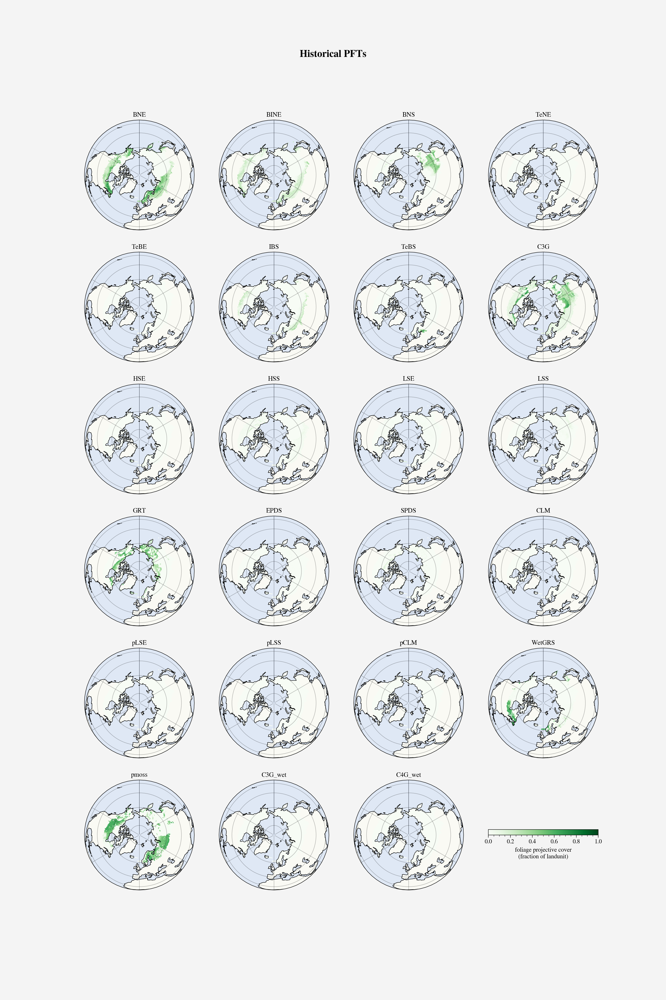

In [21]:
plot_boreal_pfts(pfts_hist, titles = pftnames, col_wrap=4, title = "Historical PFTs")

## Historical (1971-2000): comparison with CLM/NorESM

In [22]:
pfts_CLM_sel = pfts_CLM.sel(natpft=[1,2,3,5,7,8,9,10,11,12]) *lnd_frac
#plot_boreal_pfts(pfts_CLM_sel,title = "PFTs in CLM", vmax=100, col_wrap=3,
                 #titles = ["1 – TeNET","2 – BoNET","3 – BoNDT", "5 – TeBET", "7 – TeBDT", "8 – BoBDT", 
                           #"9 – TeBES", "10 – TeBDS","11 – BoBDS","12 – aC3"])

### PFTs comparison

In [17]:
df1 = pftnames_da.rename('LPJGUESS study').to_dataframe()

names = {0:'Boreal needle-leaved evergreen tree', 
         1:'Boreal shade-intolerant needle-leaved evergreen tree', 
         2:'Boreal needle-leaved summergreen tree', 
         3:'Temperate needle-leaved evergreen tree', 
         4:'Temperate broad-leaved evergreen tree', 
         5:'Shade-intolerant broad-leaved summergreen tree', 
         6:'Temperate broad-leaved summergreen tree', 
         7:'Cold C3 grass', 8:'High shrub evergreen', 
         9:'High shrub summergreeen', 10:'Low shrub evergreen', 
         11:'Low shrub summergreen', 12:'Graminoid and forb tundra', 
         13:'Evergreen prostate dwarf shrub - needleleaved', 
         14:'Summergreen prostate dwarf shrub - broadleaved', 
         15:'Cushion forb, lichen and moss', 16:'?',
         17:'?',18:'?',19:'Flood-tolerant grass/gramoid',20:'Peatland moss',
         21:'?',22:'?' }
da = xr.DataArray(list(names.values()), coords={'natpft':list(names.values())})
df2 = da.assign_coords({'natpft': range(23)}).rename('LPJ-GUESS names').to_dataframe()

veg_group = {0:'tree', 1:'tree', 2:'tree', 3:'tree', 4:'tree', 5:'tree', 6:'tree', 7:'grass', 8:'shrub', 
             9:'shrub', 10:'shrub', 11:'shrub', 12:'grass', 13:'grass', 14:'grass', 15:'grass',16:'shrub?',
             17:'shrub?', 18:'grass?',19:'grass?',20:'?',21:'grass?',22:'grass?' }
da = xr.DataArray(list(veg_group.values()), coords={'natpft':list(veg_group.values())})
df3 = da.assign_coords({'natpft': range(23)}).rename('vegetation group').to_dataframe()

corr = {0:'BoNET', 1:'BoNET', 2:'BoNDT', 3:'TeNET', 4:'TeBET', 5:'BoBDT, TeBDT', 6:'TeBDT', 
        7:'C3, articC3', 8:'TeBES', 9:'BoBDS, TeBDS', 10:'TeBES', 11:'BoBDS, TeBDS', 12:'?', 13:'?', 
        14:'?', 15:'?',16:'?',17:'?',18:'?',19:'?',20:'?',21:'?',22:'?' }
da = xr.DataArray(list(corr.values()), coords={'natpft':list(corr.values())})
df4 = da.assign_coords({'natpft': range(23)}).rename('NORESM - corresp').to_dataframe()

#pftnamesN = {0:'Bare Ground', 1:'TeNET', 2:'BoNET', 3:'BoNDT', 4:'TrBET', 5:'TeBET', 6:'TrBDT', 
             #7:'TeBDT', 8:'BoBDT', 9:'TeBES', 10:'TeBDS', 11:'BoBDS', 12:'arcticC3', 13:'C3', 14:'C4'}
#da = xr.DataArray(list(pftnamesN.values()), coords={'natpft':list(pftnamesN.values())})
#df2 = da.assign_coords({'natpft': range(15)}).rename('NORESM - indexes').to_dataframe()
#noresm_indexes = ["2","2","3","1", "5", "8,10", "7","12,13", "10,11", "10,11", "10,11", "10,11"]

corr_index = {0:2, 1:2, 2:3, 3:1, 4:5, 5:(8,7), 6:7, 7:(12,13), 8:(9), 9:(10,11), 10:(9), 
              11:(10,11), 12:'?', 13:'?', 14:'?', 15:'?',16:'?',17:'?',18:'?',19:'?',20:'?',21:'?',22:'?' }
da = xr.DataArray(list(corr_index.values()), coords={'natpft':list(corr_index.values())})
df5 = da.assign_coords({'natpft': range(23)}).rename('NORESM - indexes').to_dataframe()

dfp = df1.merge(df2, how="left", on='natpft')
dfpp = dfp.merge(df3, how="left", on='natpft')
dfppp = dfpp.merge(df4, how="left", on='natpft')
display(dfppp.merge(df5, how="left", on='natpft'))

,LPJGUESS study,LPJ-GUESS names,vegetation group,NORESM - corresp,NORESM - indexes
natpft,,,,,
0,BNE,Boreal needle-leaved evergreen tree,tree,BoNET,2
1,BINE,Boreal shade-intolerant needle-leaved evergree...,tree,BoNET,2
2,BNS,Boreal needle-leaved summergreen tree,tree,BoNDT,3
3,TeNE,Temperate needle-leaved evergreen tree,tree,TeNET,1
4,TeBE,Temperate broad-leaved evergreen tree,tree,TeBET,5
5,IBS,Shade-intolerant broad-leaved summergreen tree,tree,"BoBDT, TeBDT","(8, 7)"
6,TeBS,Temperate broad-leaved summergreen tree,tree,TeBDT,7
7,C3G,Cold C3 grass,grass,"C3, articC3","(12, 13)"
8,HSE,High shrub evergreen,shrub,TeBES,9


There are lots of doubts on conversion. By comparing the plots of occurrence & vegetation group of belonging, we can guess a classification.

**OBS! There is not an exact correspondance between the two datasets**

**Notes:**
- IBS corresponds two PFTs of CLM (BoBDT, TeBDT)
- CLM doesn't have a boreal evergreen shrub type, while LPJ-GUESS does
- LPJ-GUESS shrubs are not divided into temperate and boreal, vs CLM
- (From plots) CLM has higher presence of shrubs than LPJ-GUESS **$\rightarrow$**
- **Remind!: LPJ-GUESS works on FPC, CLM on PFT occurrence (whole canopy? not just projection...)**

**Note! When doing operations remeber there is a different grid!**

**Plot comparison is in the file `LPJGUESS-CLM-comparison.jpynb`.**

At the end, shrubs and grass in LPJGUESS look underestimated compared to CLM, but there is the moss componenents that are quite predominant in some aereas. They do not corresponds to the "missing" values from grass and shrubs, because they are on lower latitudes.

**Solutions:**
- IBS considered 100% boreal since it's on this gridlist, we make this approximation (while TeBS <-> TeBDT) $\rightarrow$ to check
- All L. shrub types are summed into the C. boreal type (many are close to 0, so they don't affect the total)
- GRT is considered shrub type in CLM -> gets closer but not perfect
- pmoss and WetGRS are not correspondet to any CLM pft (CLM doesn't have moss yet) $\rightarrow$ try to avoid this component and renormalize the others

We can notice how summing up all pfts we dont obtain the Total $\rightarrow$ we need to multiply the Natural_sum and the Peatland_sum by their respective land fraction (see above).

Since CLM doesn't have peatland pfts implemented, we do not consider these pfts [16-22] in the convertion to CLM. The normalization is already made.

In [12]:
    # Convertion scheme is (L->C):
    # 3 -> 1
    # 0,1 -> 2
    # 2 -> 3
    # 4 -> 5
    # 6 -> 7
    # 5 -> 8
    # 8,10 -> 9?
    # 9, 11,12,13,14,15 -> 11
    # 7 -> 12

## Future - GFDL-ESM4 (2071-2100)

Data from `GFDL-ESM4_SSP585_fpc2071to2100.txt`. These are the averaged FPC for period 2071-2100 for the GCM GFDL-ESM4 under SSP585.

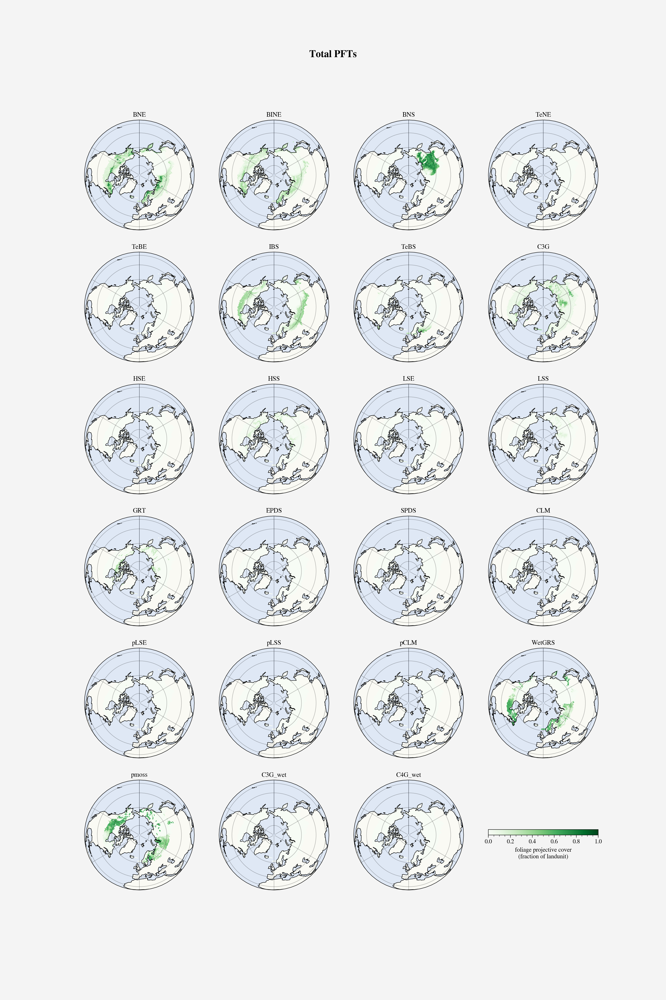

In [18]:
# Importing a txt file as a panda dataframe
fn = 'GFDL-ESM4_SSP585_fpc2071to2100.txt'
fn_path = foldername+'FPC/'+fn
    
pfts_GFDL = DataArray_from_LPJGUESS(fn_path, name='FPC_PFT', colnames=True, da_attrs=pfts_CLM,
                               main_attrs = {'long_name': 'foliage projective cover (fraction of landunit)'})
plot_boreal_pfts(pfts_GFDL, titles = pftnames, col_wrap=4, title = "Total PFTs")

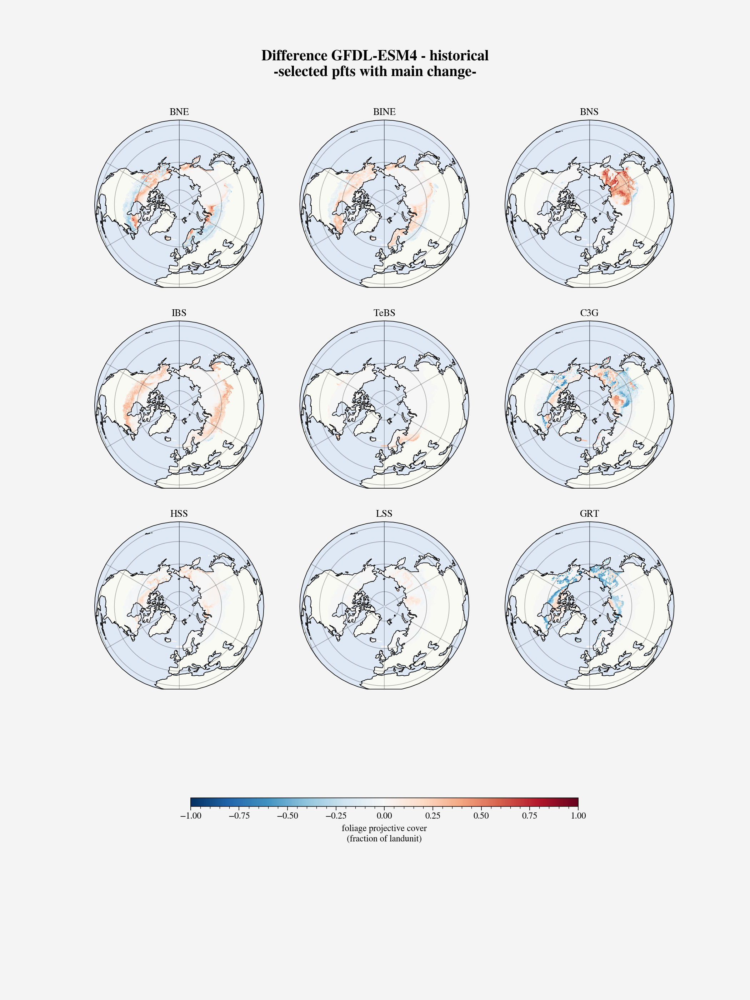

In [44]:
plot_boreal_pfts((pfts_GFDL-pfts_hist).isel(natpft=[0,1,2,5,6,7,9,11,12]), 
                 titles = [pftnames[i] for i in [0,1,2,5,6,7,9,11,12]], 
                 col_wrap=3, lat=1.,extra_cbar_axis=True,
                 title = "Difference GFDL-ESM4 - historical\n-selected pfts with main change-", cmap='burd')

## Future - MRI-ESM2 (2071-2100)

Data from `MRI-ESM2_0_SSP585_fpc2071to2100.txt`. These are the averaged FPC for period 2071-2100 for the GCM MRI-ESM2 under SSP585.

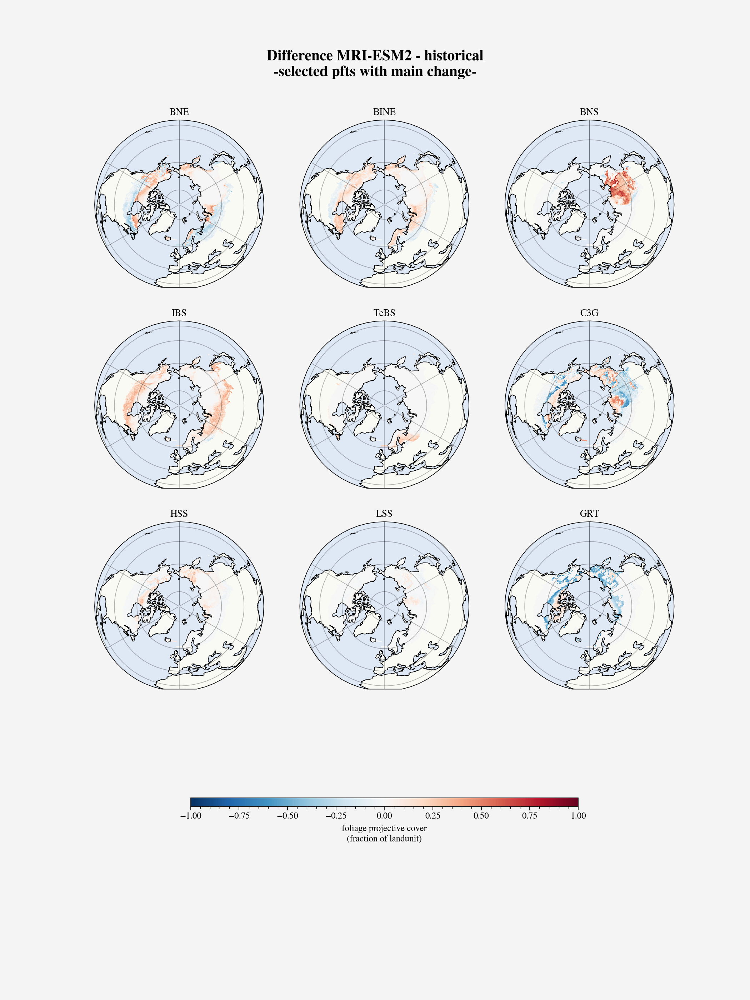

In [47]:
# Importing a txt file as a panda dataframe
fn = 'MRI-ESM2_0_SSP585_fpc2071to2100.txt'
fn_path = foldername+'FPC/'+fn
    
pfts_MRI = DataArray_from_LPJGUESS(fn_path, name='FPC_PFT', colnames=True, da_attrs=pfts_CLM,
                               main_attrs = {'long_name': 'foliage projective cover (fraction of landunit)'})
plot_boreal_pfts(pfts_MRI-pfts_hist.isel(natpft=[0,1,2,5,6,7,9,11,12]), 
                 titles = [pftnames[i] for i in [0,1,2,5,6,7,9,11,12]], 
                 col_wrap=3, lat=1.,extra_cbar_axis=True,
                 title = "Difference MRI-ESM2 - historical\n-selected pfts with main change-", cmap='burd')

## Future - CanESM5 (2071-2100)

Data from `CanESM5_SSP585_fpc2071to2100.txt`. These are the averaged FPC for period 2071-2100 for the GCM CanESM5 under SSP585.

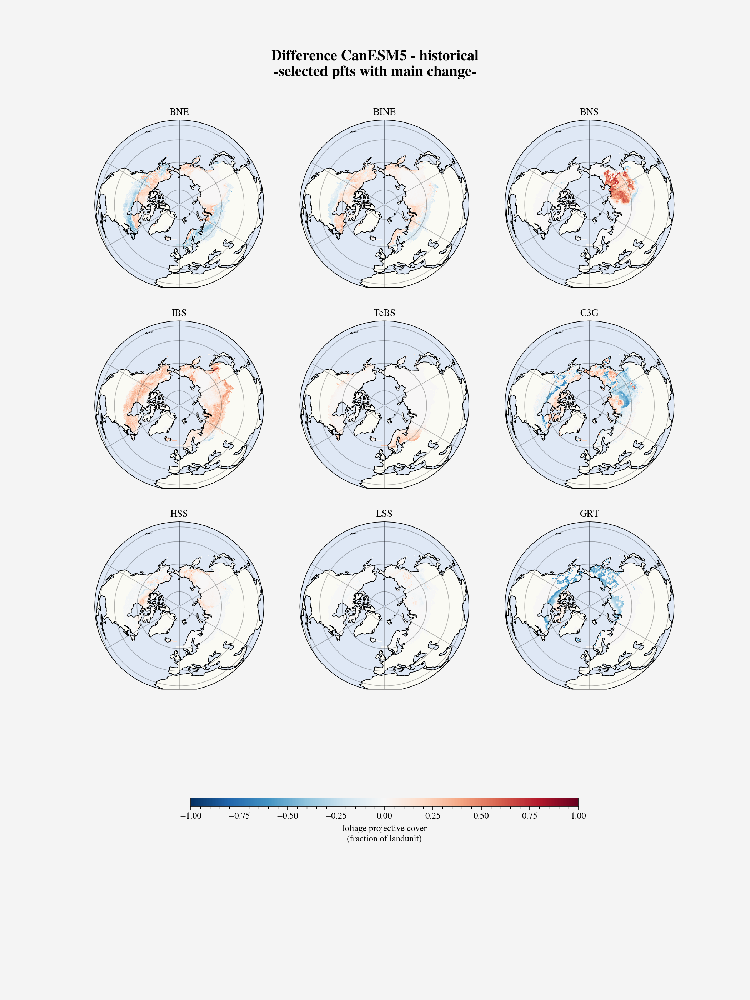

In [46]:
# Importing a txt file as a panda dataframe
fn = 'CanESM5_SSP585_fpc2071to2100.txt'
fn_path = foldername+'FPC/'+fn
    
pfts_Can = DataArray_from_LPJGUESS(fn_path, name='FPC_PFT', colnames=True, da_attrs=pfts_CLM,
                               main_attrs = {'long_name': 'foliage projective cover (fraction of landunit)'})
plot_boreal_pfts(pfts_Can-pfts_hist.isel(natpft=[0,1,2,5,6,7,9,11,12]), 
                 titles = [pftnames[i] for i in [0,1,2,5,6,7,9,11,12]], 
                 col_wrap=3, lat=1.,extra_cbar_axis=True,
                 title = "Difference CanESM5 - historical\n-selected pfts with main change-", cmap='burd')

All different GCM climate forcing predict similar behaviour in the vegetation change. I'll choose the  GFDL-ESM4 as climate forcing for the future vegetation shift in the surfdata file.

## <div class="alert alert-success">Appendix: What are the dominant PFTs in the boreal area? </div>

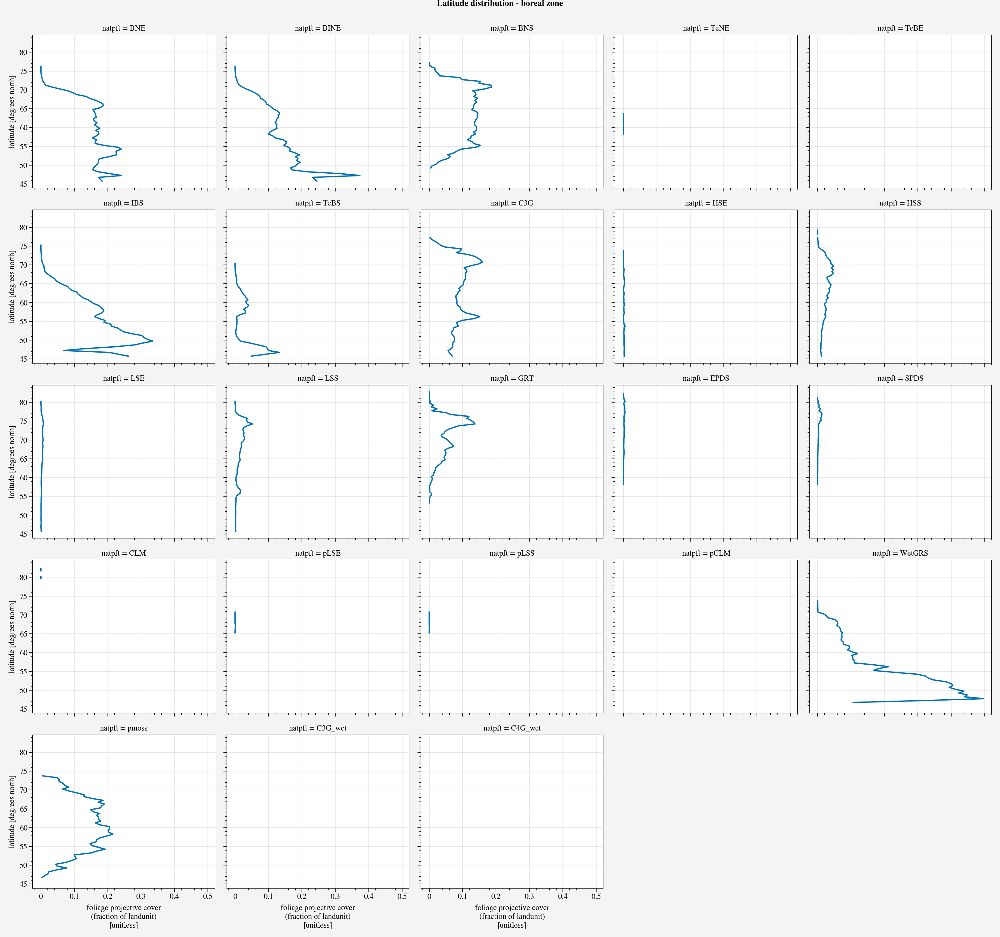

In [14]:
boreal_lat=45

c = pfts.sel(lat=slice(boreal_lat,90)).mean('lon')
c.where(c>0.).plot(y='lat',col='natpft', col_wrap=5)
plt.suptitle("Latitude distribution - boreal zone", y=1)
plt.tight_layout()
plt.show()

The historical boreal PFTs are pft=[0,1,2,5,7,12,19,20].

In [15]:
boreal_list=[0,1,2,5,7,12,19,20]
borealnames = []
for i in boreal_list: borealnames.append(pftnames[i])
print("Boreal PFTs: ", borealnames)

Boreal PFTs:  ['BNE', 'BINE', 'BNS', 'IBS', 'C3G', 'GRT', 'WetGRS', 'pmoss']


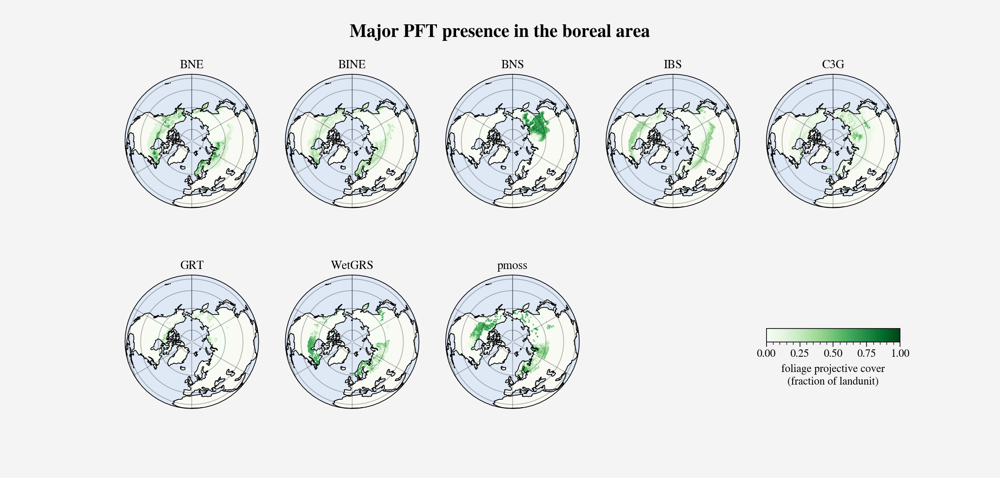

In [16]:
boreal_indexes=[0,1,2,5,7,12,19,20]
boreal_pfts = pfts.isel(natpft=boreal_indexes)
plot_boreal_pfts(boreal_pfts,col_wrap=5, figsize=(11.5,5.5), title = "Major PFT presence in the boreal area", titles = borealnames)

# <div class="alert alert-success">LAI</div> 

## Historical (1971-2000)

In [17]:
fn = 'lai1971to2000.txt'
lai7100 = pd.read_csv(foldername+'LAI/'+fn, delim_whitespace=True)#, index_col=[0,1])
lai7100.set_index(['Lat', 'Lon'], inplace=True)

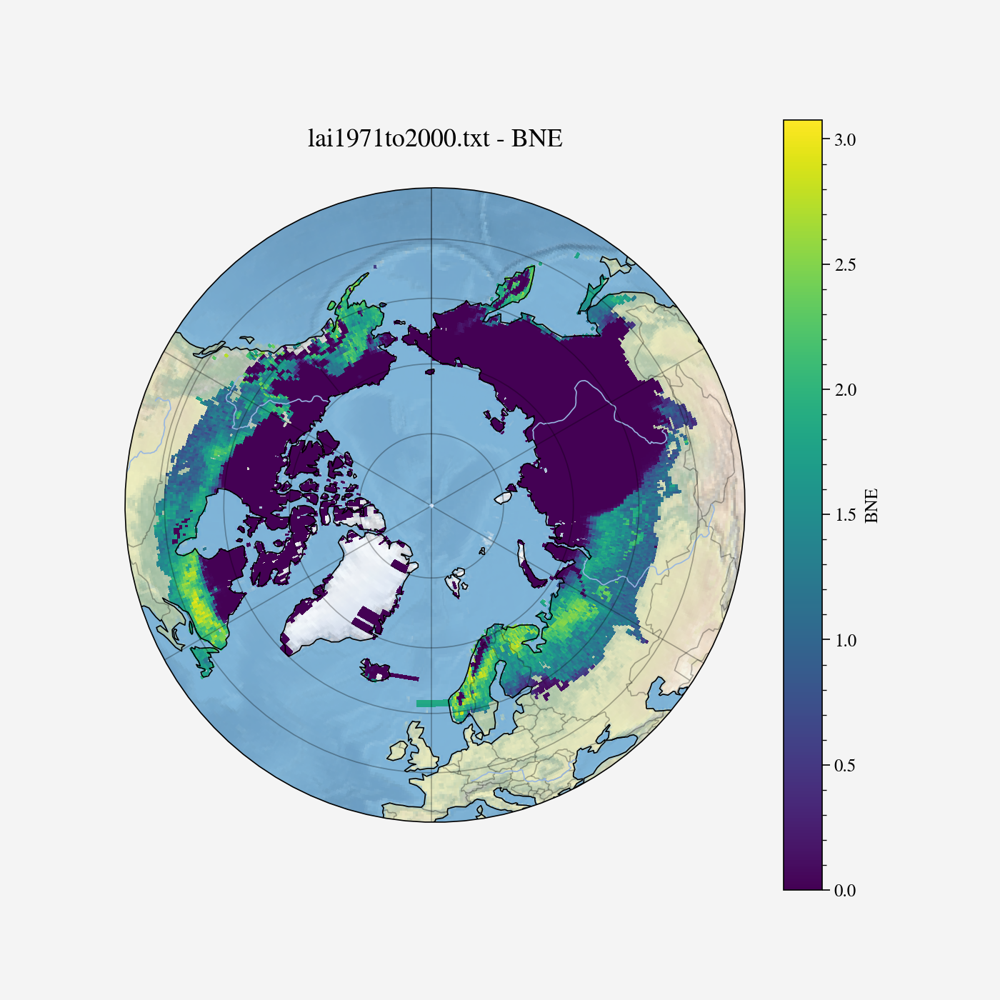

In [18]:
fig = plt.figure(1, figsize=[7,7])
ax = plt.axes(projection=ccrs.Orthographic(0, 90))
cut_extent_Orthographic(ax, lat=40)
lai7100.to_xarray()['BNE'].plot(ax=ax, x='Lon', y='Lat', transform=ccrs.PlateCarree())
ax_map_properties(ax, earth=True)
ax.set_title(fn+ ' - BNE',y=1.05,size='x-large') #, y=1.15, 
#plt.tight_layout()
plt.show()

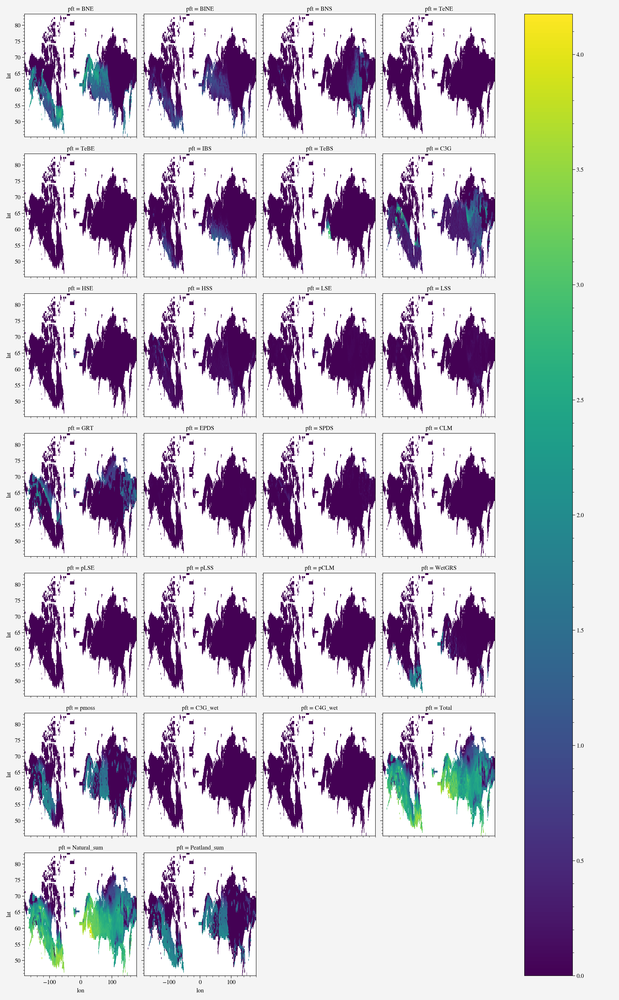

In [19]:
i_df = lai7100 # data is a dictionary of properly indexed dataframes
da = xr.DataArray(lai7100.values, coords={'lonlat':i_df.index,'pft':i_df.columns.values})#.assign_coords(expand_dims(['Lat', 'Lon'])#,dims=['lonlat','pft'])
da = da.unstack().rename({'Lat': 'lat', 'Lon': 'lon'})
da.plot(col='pft', col_wrap=4)

In [20]:
lai7100.to_xarray()

<xarray.Dataset>
Dimensions:       (Lat: 75, Lon: 638)
Coordinates:
  * Lat           (Lat) float64 45.75 46.75 47.25 47.75 ... 82.25 82.75 83.25
  * Lon           (Lon) float64 -179.8 -179.2 -178.8 ... 178.8 179.2 179.8
Data variables: (12/26)
    BNE           (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    BINE          (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    BNS           (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    TeNE          (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    TeBE          (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    IBS           (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    ...            ...
    pmoss         (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    C3G_wet       (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    C4G_wet       (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    Total         (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    Natural_sum   (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan
    Peatland_sum  (Lat, Lon) float64 nan nan nan nan nan ... nan nan nan nan nan

In [21]:
pft_names = list(lai7100.columns.values)
lai7100.columns = [i for i in range(len(pft_names))]
lai7100

0       1    2    3    4       5    6       7    8   \
Lat   Lon                                                                
57.25 -95.75   1.7220  0.5760  0.0  0.0  0.0  0.0112  0.0  0.2411  0.0   
      -95.25   1.7103  0.4146  0.0  0.0  0.0  0.0136  0.0  0.3090  0.0   
      -94.75   1.6124  0.4773  0.0  0.0  0.0  0.0087  0.0  0.4006  0.0   
      -94.25   1.7206  0.1560  0.0  0.0  0.0  0.0018  0.0  0.4363  0.0   
      -93.75   1.7208  0.1906  0.0  0.0  0.0  0.0022  0.0  0.4435  0.0   
...               ...     ...  ...  ...  ...     ...  ...     ...  ...   
72.25 -105.75  0.0000  0.0000  0.0  0.0  0.0  0.0000  0.0  0.0000  0.0   
      -105.25  0.0000  0.0000  0.0  0.0  0.0  0.0000  0.0  0.0000  0.0   
      -100.75  0.0000  0.0000  0.0  0.0  0.0  0.0000  0.0  0.0000  0.0   
      -100.25  0.0000  0.0000  0.0  0.0  0.0  0.0000  0.0  0.0000  0.0   
      -99.75   0.0000  0.0000  0.0  0.0  0.0  0.0000  0.0  0.0000  0.0   

                   9   ...   16   17   18      19      20   21   22      23  \
Lat   Lon              ...                                                    
57.25 -95.75   0.0920  ...  0.0  0.0  0.0  0.0093  1.5369  0.0  0.0  2.1088   
      -95.25   0.0956  ...  0.0  0.0  0.0  0.0108  1.5927  0.0  0.0  2.0214   
      -94.75   0.0841  ...  0.0  0.0  0.0  0.0106  1.6059  0.0  0.0  2.0362   
      -94.25   0.0191  ...  0.0  0.0  0.0  0.0084  1.5510  0.0  0.0  1.8017   
      -93.75   0.0359  ...  0.0  0.0  0.0  0.0148  1.6763  0.0  0.0  1.9249   
...               ...  ...  ...  ...  ...     ...     ...  ...  ...     ...   
72.25 -105.75  0.0000  ...  0.0  0.0  0.0  0.0000  0.0000  0.0  0.0  0.0098   
      -105.25  0.0000  ...  0.0  0.0  0.0  0.0000  0.0000  0.0  0.0  0.0092   
      -100.75  0.0000  ...  0.0  0.0  0.0  0.0000  0.0000  0.0  0.0  0.0071   
      -100.25  0.0000  ...  0.0  0.0  0.0  0.0000  0.0000  0.0  0.0  0.0076   
      -99.75   0.0000  ...  0.0  0.0  0.0  0.0000  0.0000  0.0  0.0  0.0070   

                   24      25  
Lat   Lon                      
57.25 -95.75   2.6493  1.5462  
      -95.25   2.5533  1.6035  
      -94.75   2.5926  1.6165  
      -94.25   2.3411  1.5594  
      -93.75   2.3998  1.6910  
...               ...     ...  
72.25 -105.75  0.0098  0.0000  
      -105.25  0.0092  0.0000  
      -100.75  0.0071  0.0000  
      -100.25  0.0076  0.0000  
      -99.75   0.0070  0.0000  

[16750 rows x 26 columns]

In [22]:
da

<xarray.DataArray (pft: 26, lat: 75, lon: 638)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]])
Coordinates:
  * pft      (pft) object 'BNE' 'BINE' 'BNS' ... 'Natural_sum' 'Peatland_sum'
  * lat      (lat) float64 45.75 46.75 47.25 47.75 ... 81.75 82.25 82.75 83.25
  * lon      (lon) float64 -179.8 -179.2 -178.8 -178.2 ... 178.8 179.2 179.8

In [23]:
pft = pd.read_csv(foldername+fn, delim_whitespace=True)
pft = pft.drop(columns=['Lon', 'Lat']).T
pft.index = [i for i in range(len(pft_names))]
pft.index.name

FileNotFoundError: [Errno 2] No such file or directory: '../data/LPJ-GUESS/lai1971to2000.txt'

In [ ]:
lai = lai7100.T
lai.index.name = 'pft'
lai

In [ ]:
lai7100.to_xarray()

In [ ]:
import itertools

data = {}
for i in np.arange(500):
    data[i] = pd.DataFrame(np.random.randn(1000, 8), index=pd.date_range(start='01.01.2013',periods=1000,freq='h'),
                    columns=list('ABCDEFGH'))
df_catalogue = pd.DataFrame(np.random.choice(10,(500, 3)), columns=['temp','pre','zon'])


In [ ]:
data[0]

In [ ]:
i_df = data[0] # data is a dictionary of properly indexed dataframes
da = xr.DataArray(i_df.values,
                   coords={'time':i_df.index.values,'runs':i_df.columns.values},
                   dims=['time','runs'])

In [ ]:
da

In [ ]:


data = pd.read_csv('output_list.txt', sep=" ")#, header=None)
#data.columns = ["a", "b", "c", "etc."]

In [ ]:
fn_url = "https://www.dropbox.com/sh/m51ks49hxt2bmta/AACAbxio0XN5xGwOWW_PoCdea/gridlist45N_tundraboreal.txt?dl=0"


In [ ]:
fn_url_f= "https://www.dropbox.com/sh/m51ks49hxt2bmta/AACAbxio0XN5xGwOWW_PoCdea?dl=1"

In [ ]:
url = fn_url  # dl=1 is important
import urllib.request
u = urllib.request.urlopen(url)
data = u.read()
u.close()
 
with open([filename], "wb") as f :
    f.write(data)

In [ ]:
import pandas as pd
import urllib.request

data = pd.read_csv(fn_url, sep=" ", error_bad_lines=False)#, header=None)
#data.columns = ["a", "b", "c", "etc."]

In [ ]:
display(data)

In [ ]:
import requests
r = requests.get(fn_url_f)   
print(r.text)

In [ ]:
df = pd.read_html()
